In [3]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt
import os
import re
import skimage as sk

# image_path = "10-07_Pictures/20241007-1A.dng"
# image = cv.imread(image_path)

# gray_image = cv.cvtColor(image, cv.COLOR_BGR2GRAY)

# blurred_image = cv.GaussianBlur(gray_image,(3,3),0)


# Gx = cv.Sobel(blurred_image,cv.CV_64F,1,0,ksize=3)
# Gy = cv.Sobel(blurred_image,cv.CV_64F,0,1,ksize=3)

# G = cv.convertScaleAbs(cv.magnitude(Gx, Gy))

# plt.figure(figsize=(15,10))

# plt.subplot(2,2,1)
# plt.imshow(cv.cvtColor(image,cv.COLOR_BGR2RGB))
# plt.title('Original Image')

# plt.subplot(2,2,2)
# plt.imshow(Gx,cmap='gray')
# plt.title('Gradient in the X direction')

# plt.subplot(2,2,3)
# plt.imshow(Gy,cmap='gray')
# plt.title('Gradient in the Y direction')

# plt.subplot(2,2,4)
# plt.imshow(G,cmap='gray')
# plt.title('Edge Detection')

# plt.show()


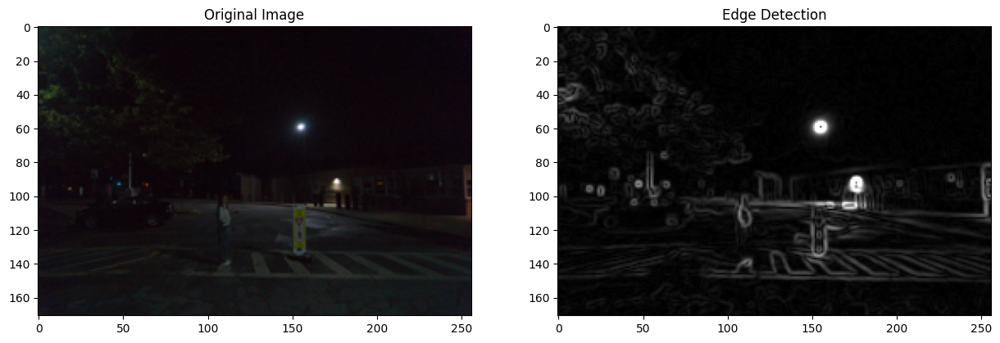

12.476516812865498


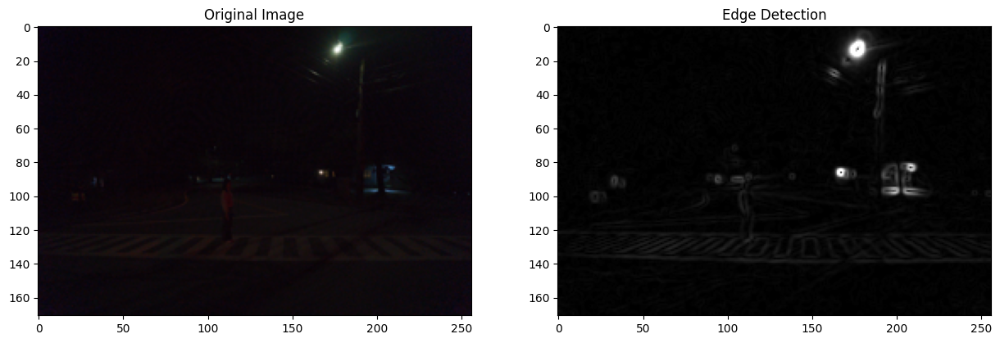

6.369174890350878


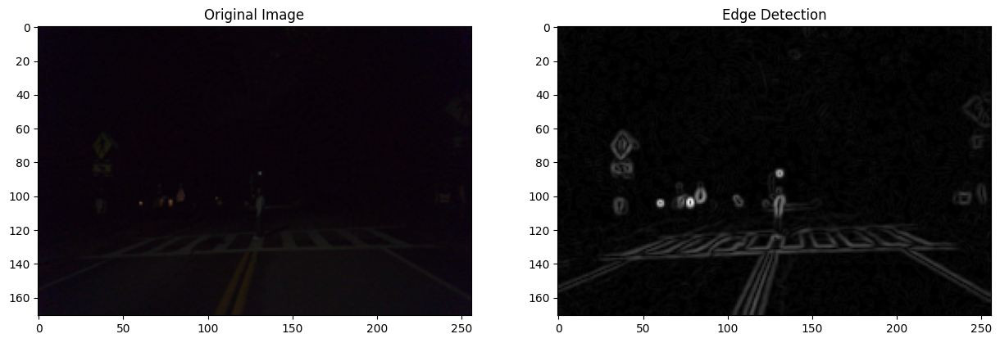

4.970394736842105


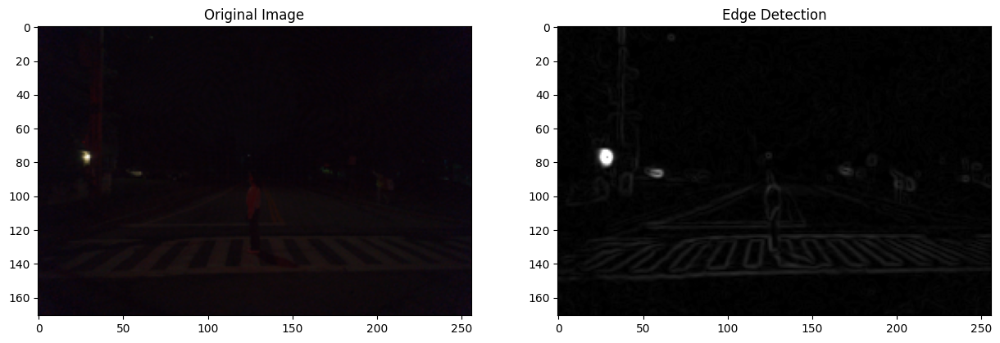

5.666415387426901


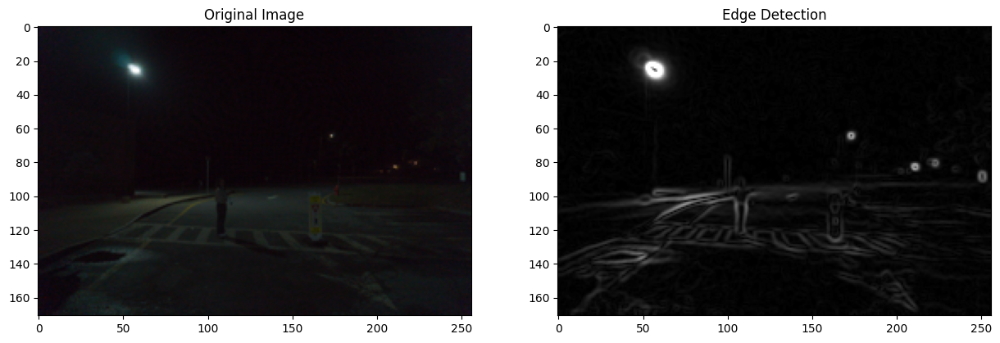

9.20266812865497


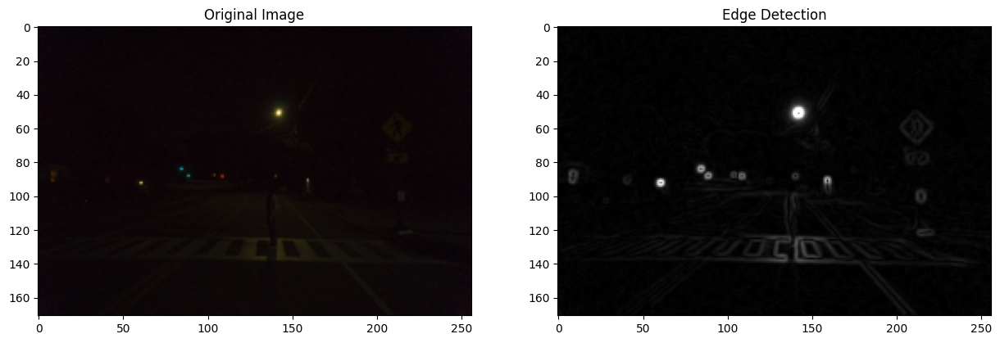

5.485243055555555


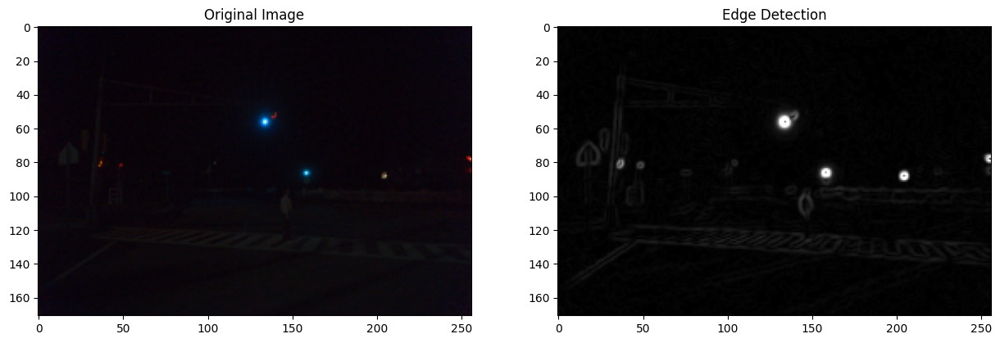

5.370568347953216


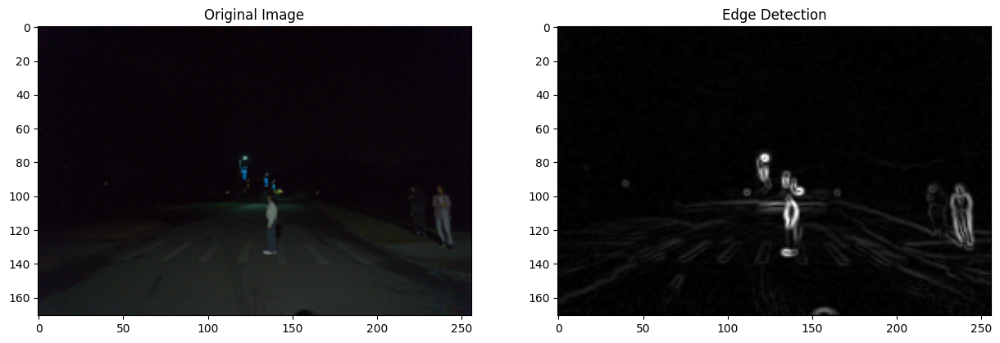

7.157392178362573


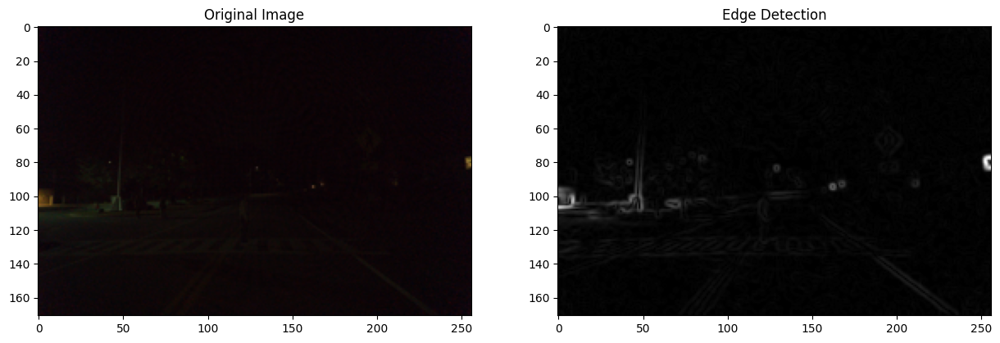

4.80953033625731


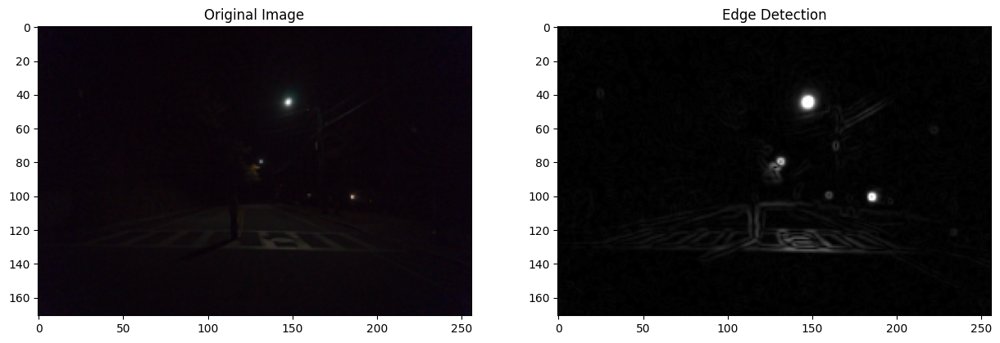

5.1170504385964914


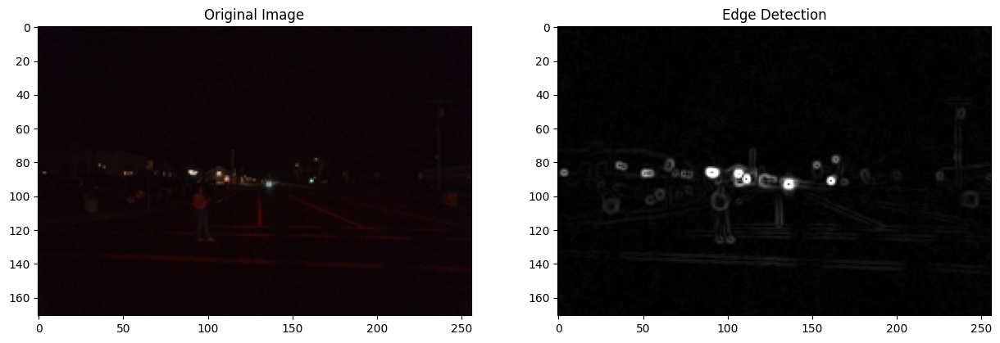

5.95796783625731


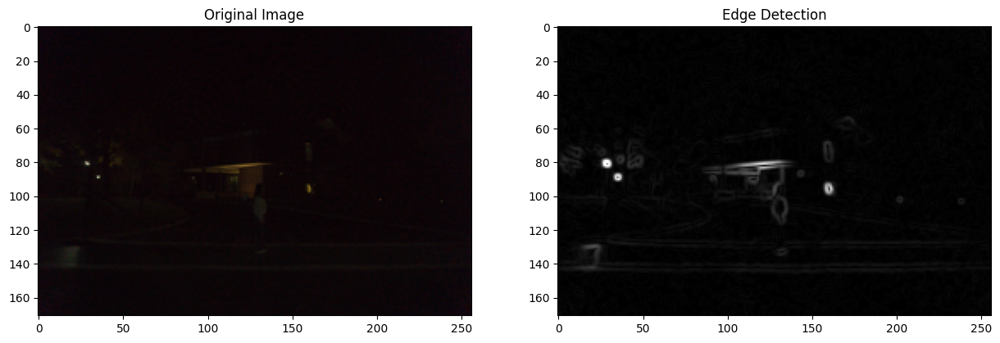

5.223729897660819


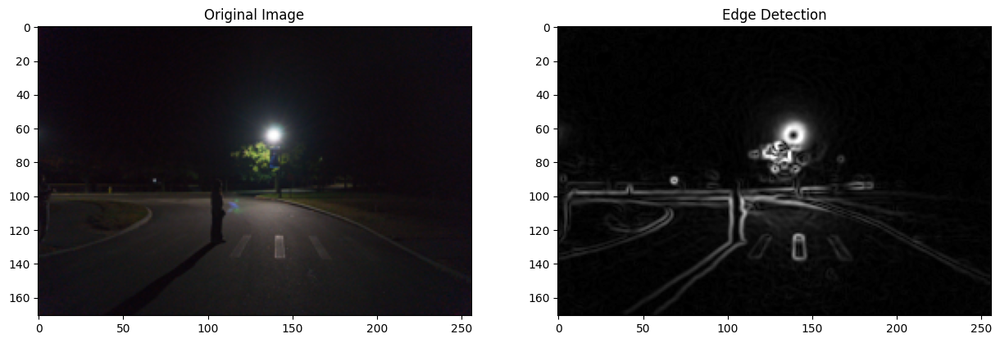

10.927471673976608


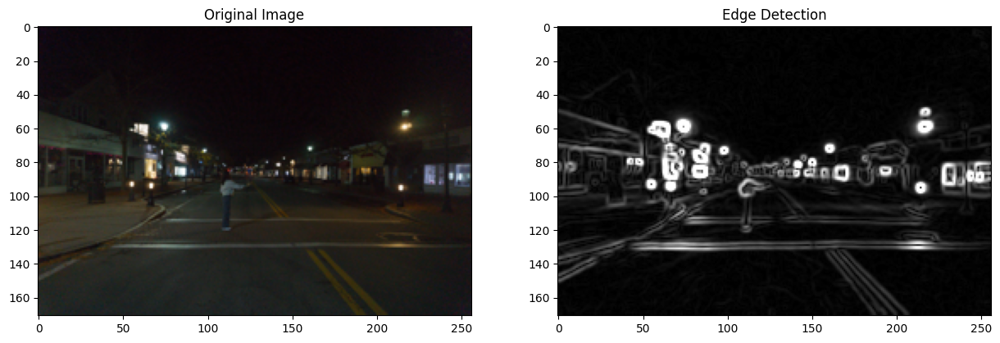

21.82625182748538


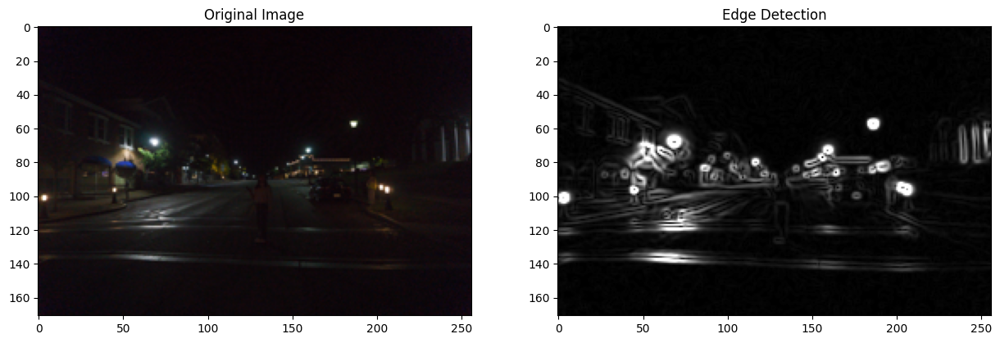

16.38013980263158


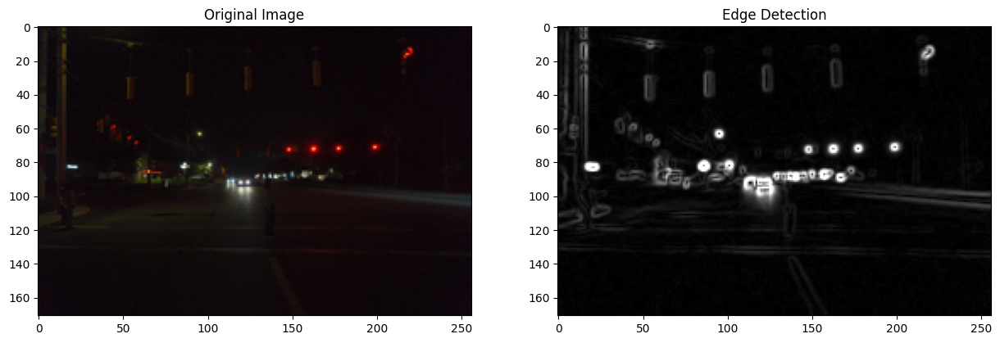

12.095531798245615


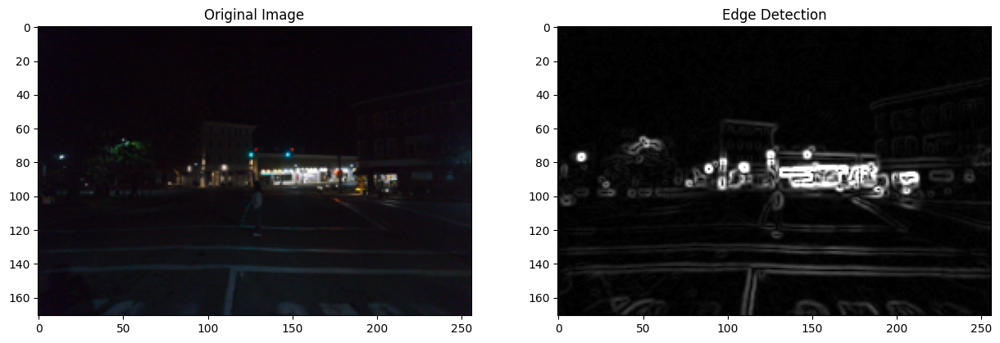

15.15060763888889


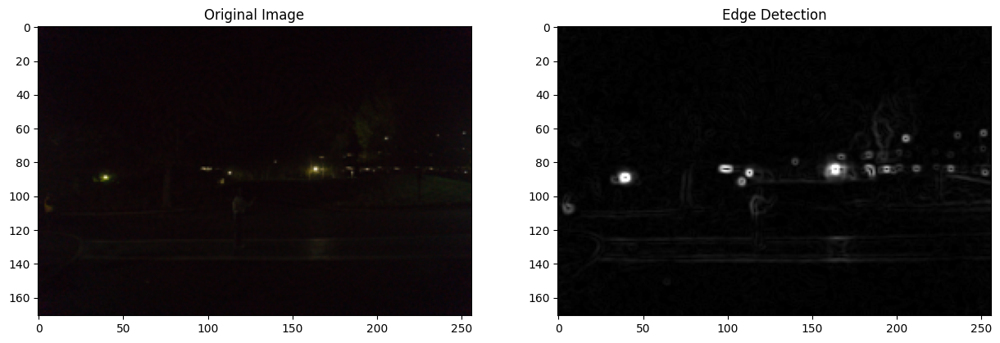

6.062043128654971


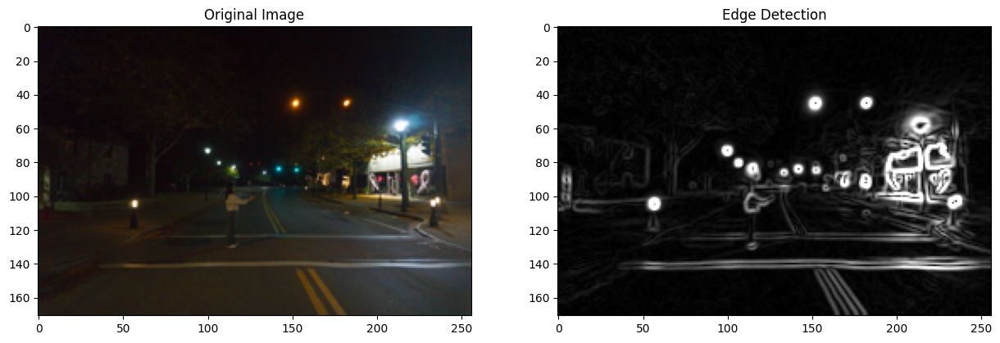

23.82424159356725


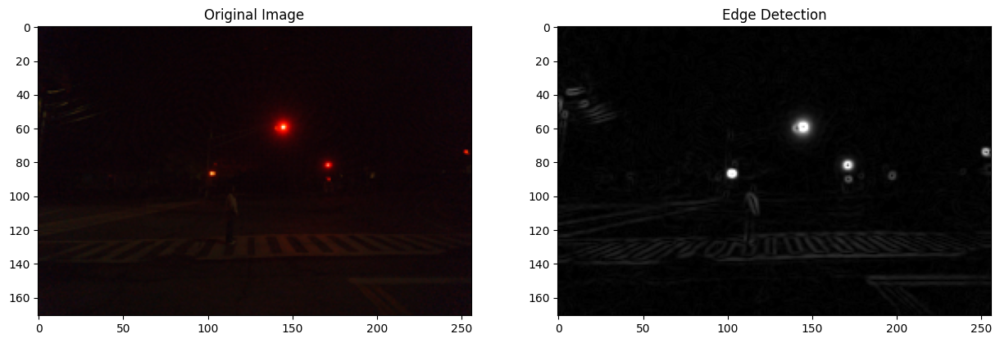

6.31421326754386


In [77]:
def sobel_edges(image_path):
    image = cv.imread(str(image_path))
    gray_image = cv.cvtColor(image, cv.COLOR_BGR2GRAY)

    blurred_image = cv.GaussianBlur(gray_image,(3,3),0)


    Gx = cv.Sobel(blurred_image,cv.CV_64F,1,0,ksize=3)
    Gy = cv.Sobel(blurred_image,cv.CV_64F,0,1,ksize=3)

    G = cv.convertScaleAbs(cv.magnitude(Gx, Gy))

    avg_g = np.mean(G)

    plt.figure(figsize=(15,10))

    plt.subplot(1,2,1)
    plt.imshow(cv.cvtColor(image,cv.COLOR_BGR2RGB))
    plt.title('Original Image')
    
    plt.subplot(1,2,2)
    plt.imshow(G,cmap='gray')
    plt.title('Edge Detection')

    plt.show()
    print(avg_g)

directory = "10-07_Pictures/"

for filename in os.listdir(directory):
    image_path = os.path.join(directory, filename)
    sobel_edges(image_path)
# sobel_edges("10-07_Pictures/20241007-1A.dng",100)



In [78]:
from pathlib import Path


from pedestrian_detection import (
    preprocess_image,
    resize_image,
    detect_pedestrians,
    upscale_boxes,
    draw_boxes,
    get_image_dir_from_env,
)

import pedestrian_illuminance as pi

image_dir = get_image_dir_from_env()
all_data = []

image_dir_path = Path("10-07_Pictures/20241007-3B.dng")
destination = Path("./cropped_images")



str_path = image_dir_path.as_posix()
if not destination.exists():
    os.makedirs(destination)
original_image = pi.read_raw_image(str_path)
enhanced_image = preprocess_image(str_path)
resized_image, scale_factor = resize_image(enhanced_image)
results = detect_pedestrians(resized_image)
boxes = upscale_boxes(results, scale_factor)

luminances = []
rms_data = []
csv_data = []
image_name = image_dir_path.name.split(".")[0]

for idx, box in enumerate(boxes):
    print(box)
    cropped = pi.crop_image(original_image, *box[:4])
    image_name = image_dir_path.name.split(".")[0]
    result_image_path = destination.joinpath(image_name + str(idx) + "-cv.jpg").as_posix()
    cv.imwrite(
        result_image_path,
        cropped
    )
    # directory = "cropped_images"

    # for filename in os.listdir(directory):
    #     image_path = os.path.join(directory, filename)
    #     edges = detect_edges(image_path)

        # plt.imshow(edges)
    


0: 448x640 (no detections), 264.9ms
Speed: 2.3ms preprocess, 264.9ms inference, 0.4ms postprocess per image at shape (1, 3, 448, 640)


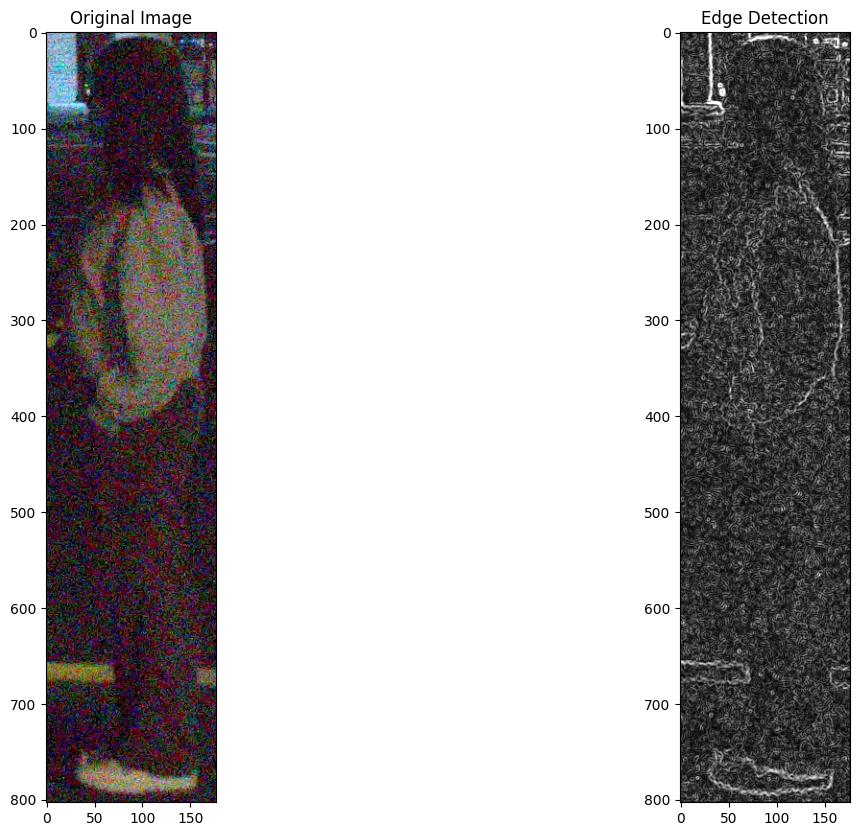

56.05625795920665
20241007-10A0-cv.jpg


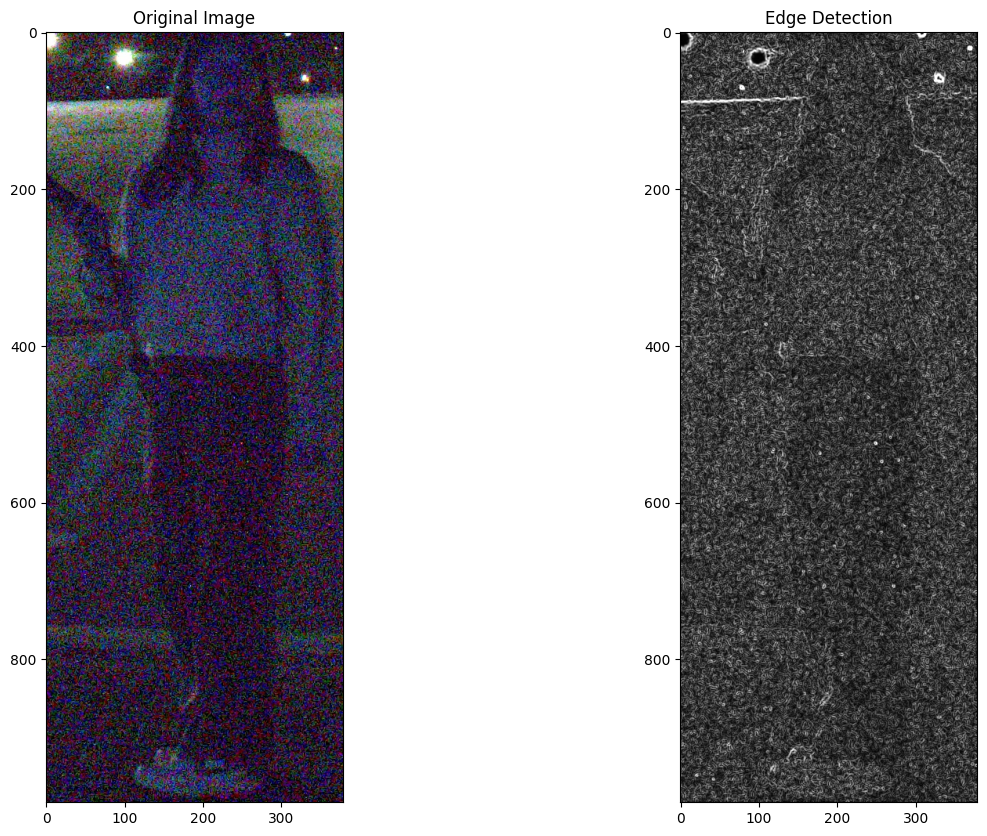

59.007478050338605
20241007-10B0-cv.jpg


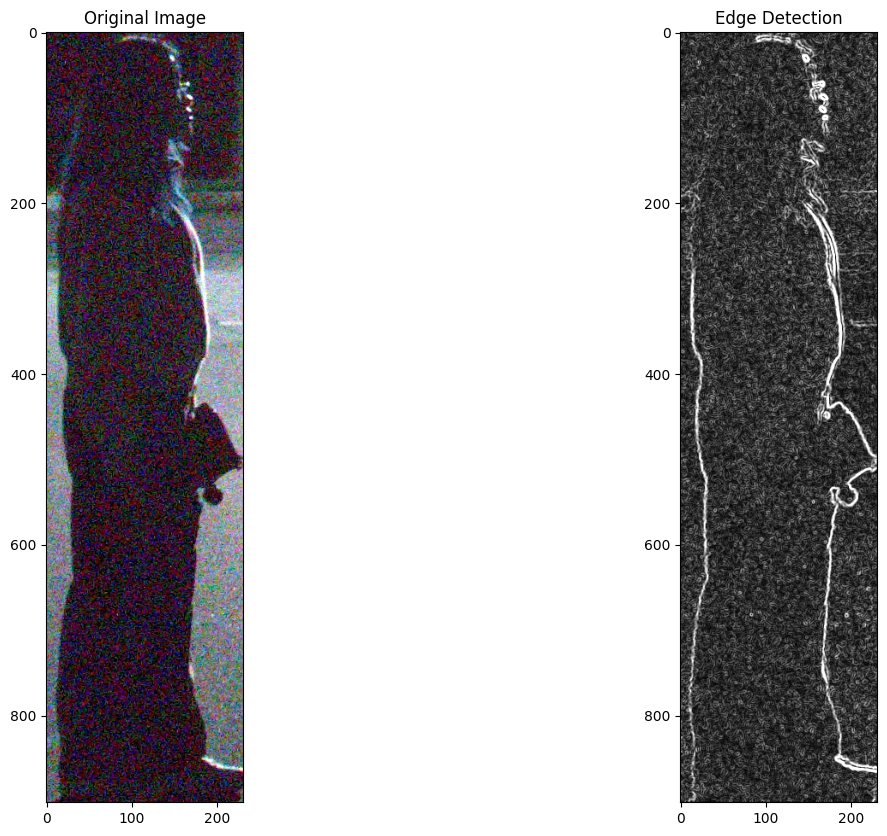

57.789515362686096
20241007-1A1-cv.jpg


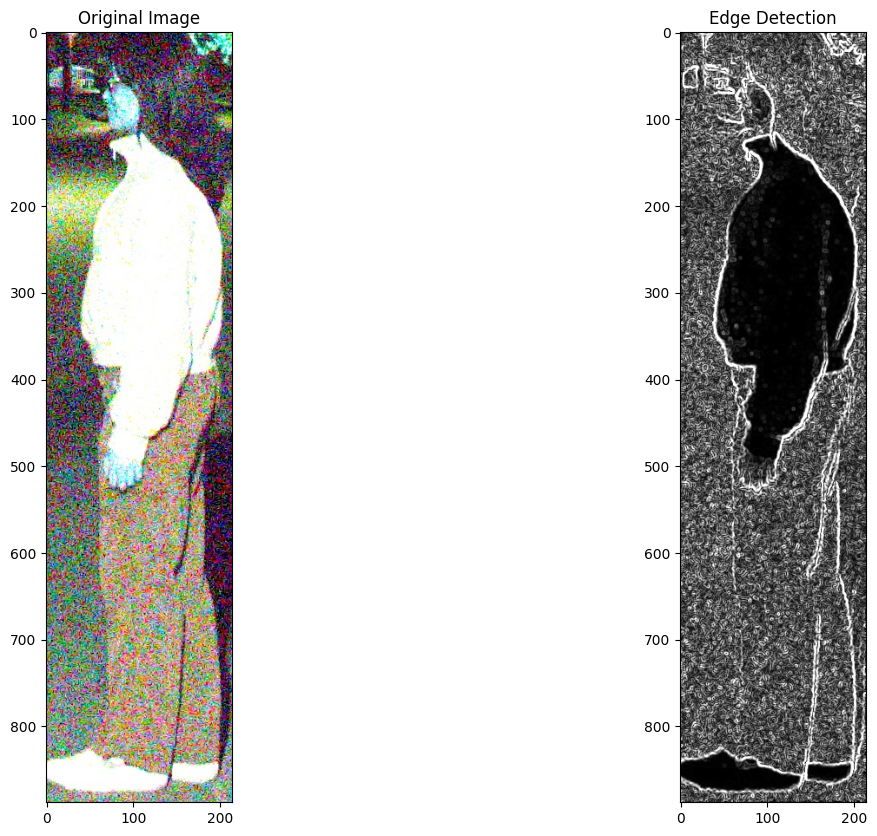

77.2512682074598
20241007-1B2-cv.jpg


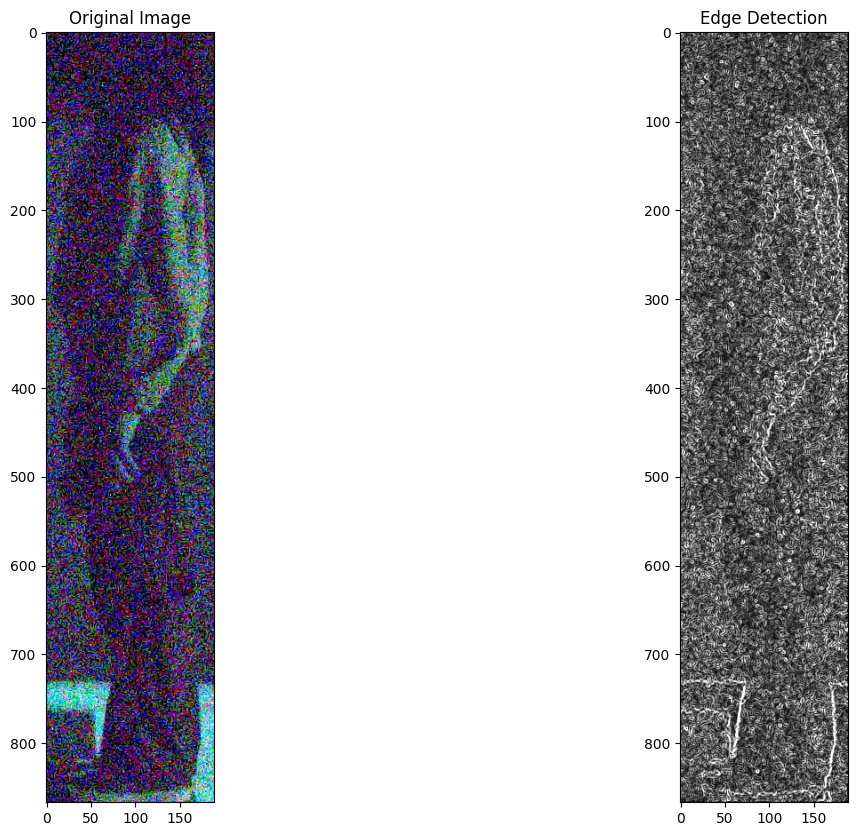

90.70472284774476
20241007-2A0-cv.jpg


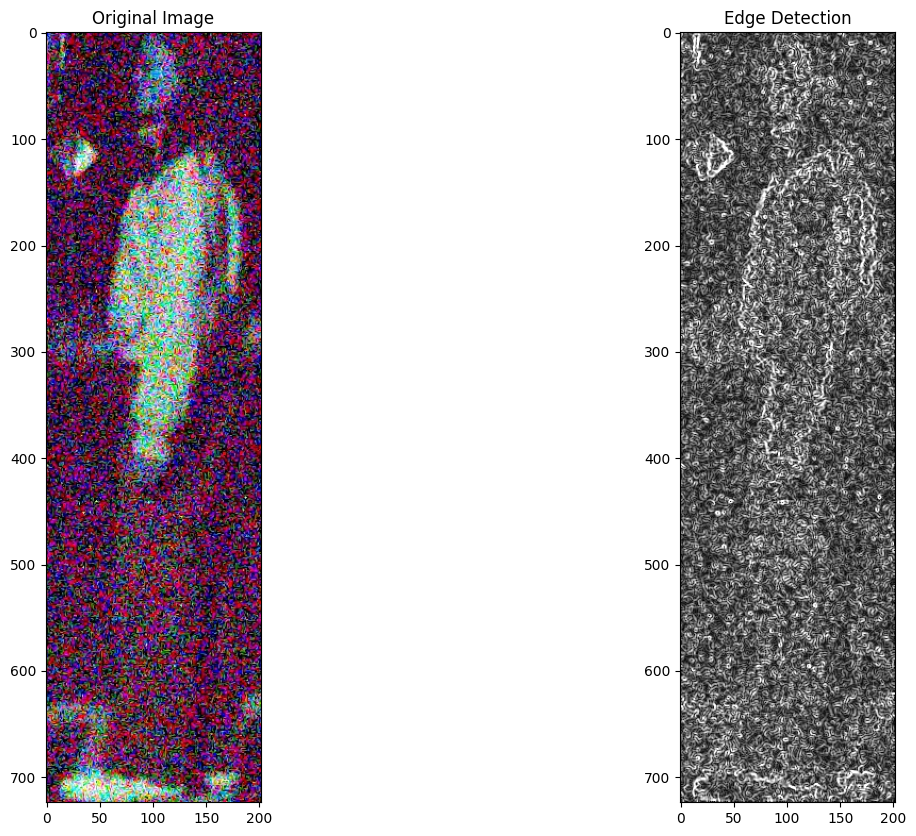

96.06299573327499
20241007-3A0-cv.jpg


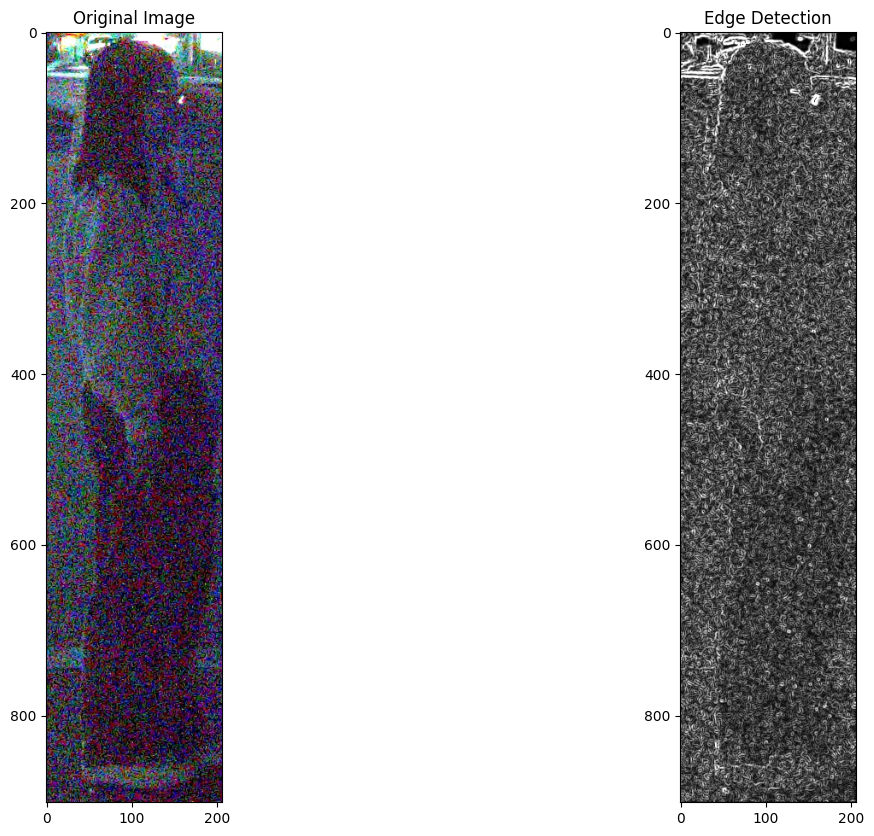

75.21595483607086
20241007-4A0-cv.jpg


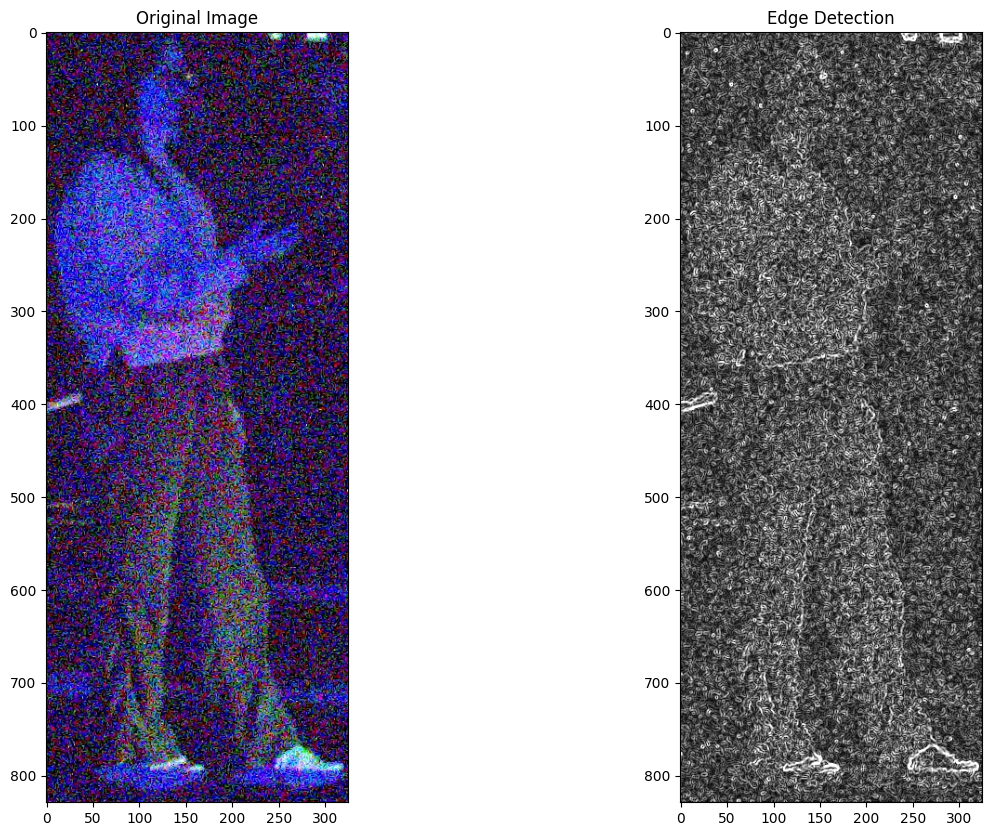

83.47333395193468
20241007-4B0-cv.jpg


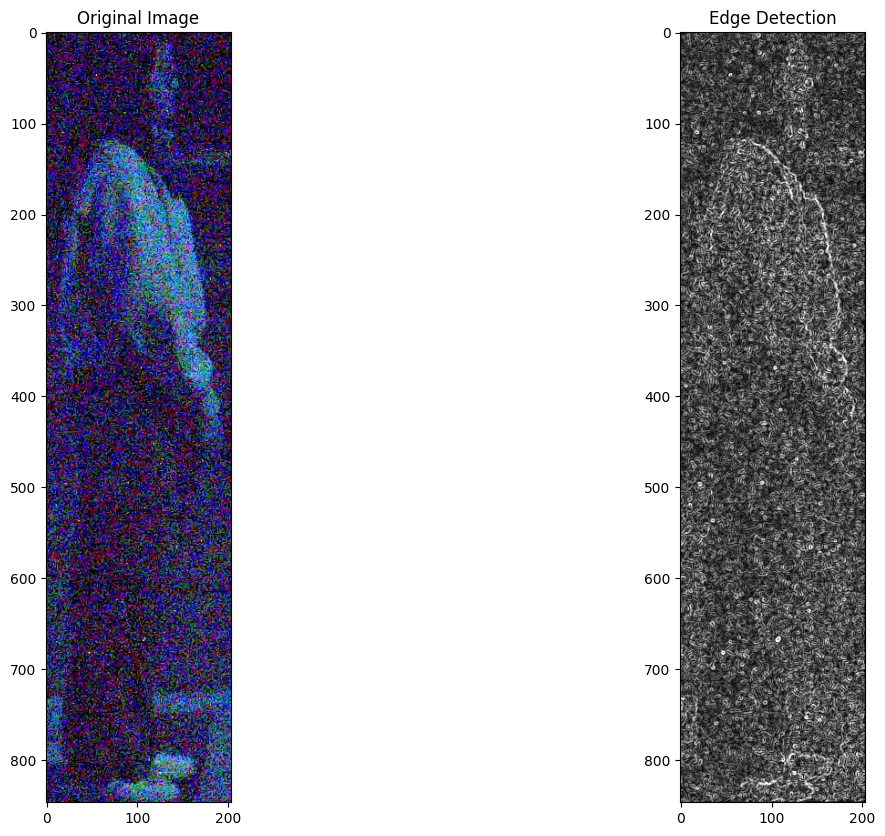

76.74236511361455
20241007-5A0-cv.jpg


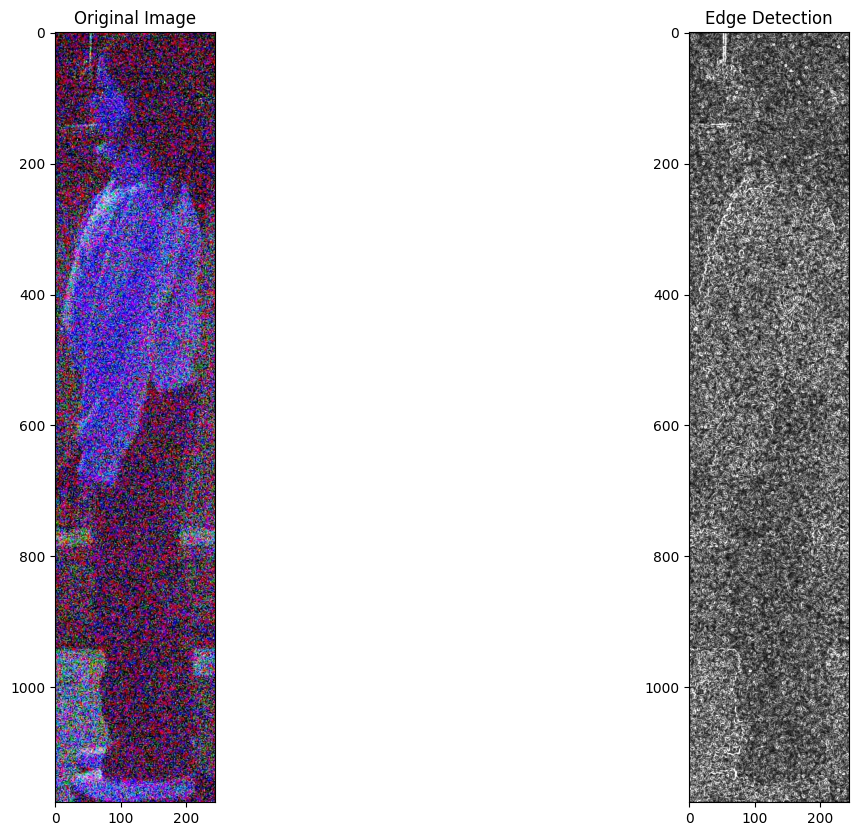

100.2084478689435
20241007-5B0-cv.jpg


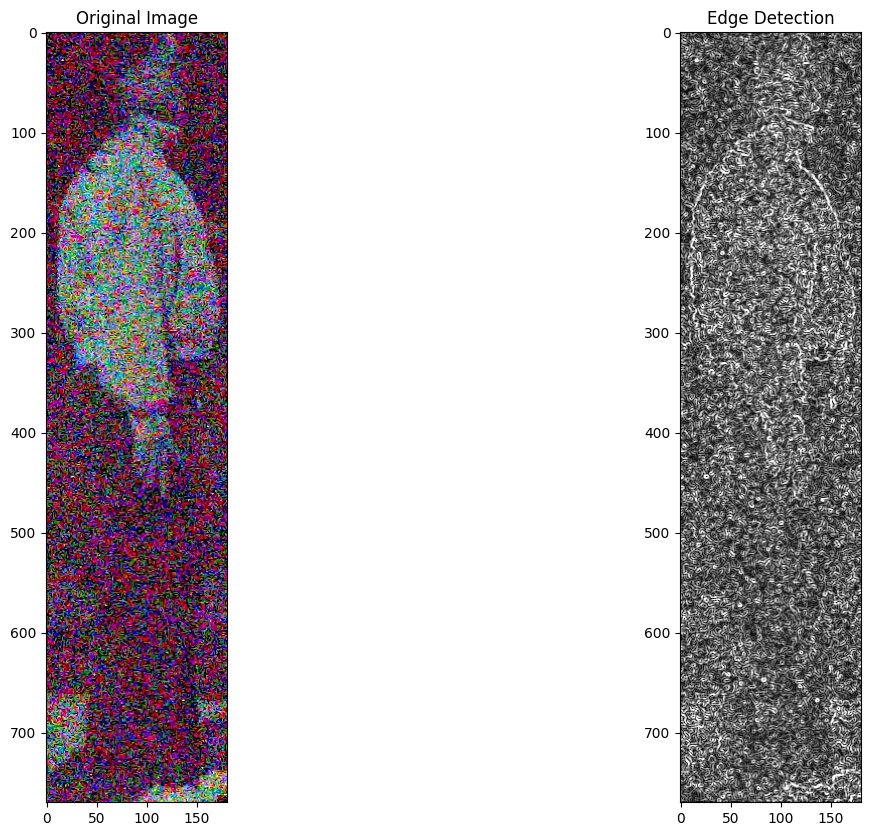

100.01965272296763
20241007-6A0-cv.jpg


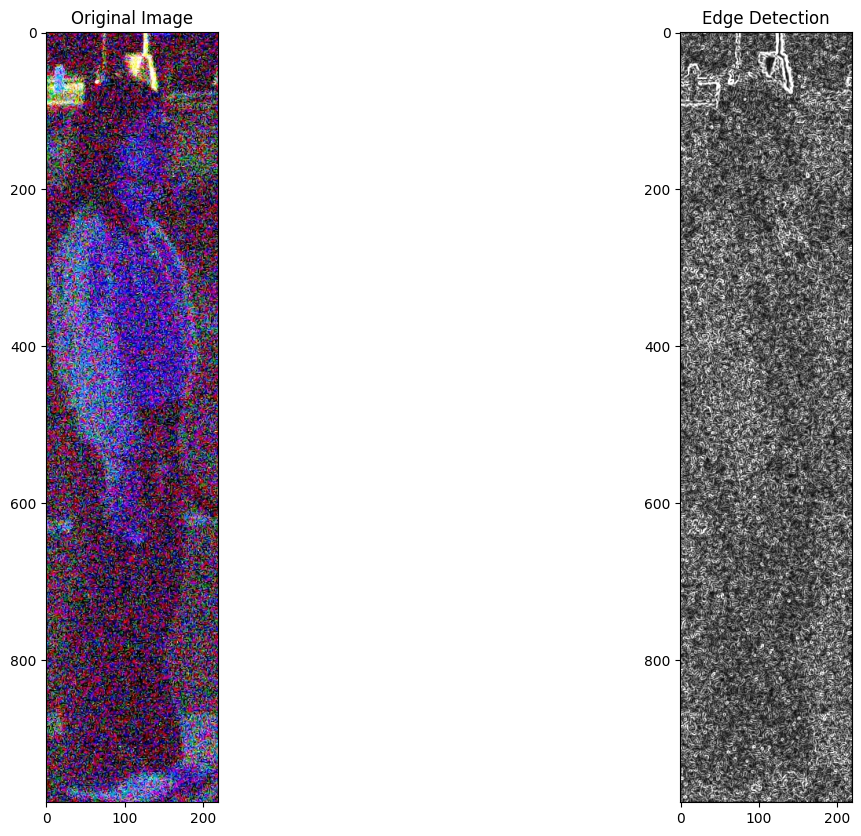

96.44066716885678
20241007-6B0-cv.jpg


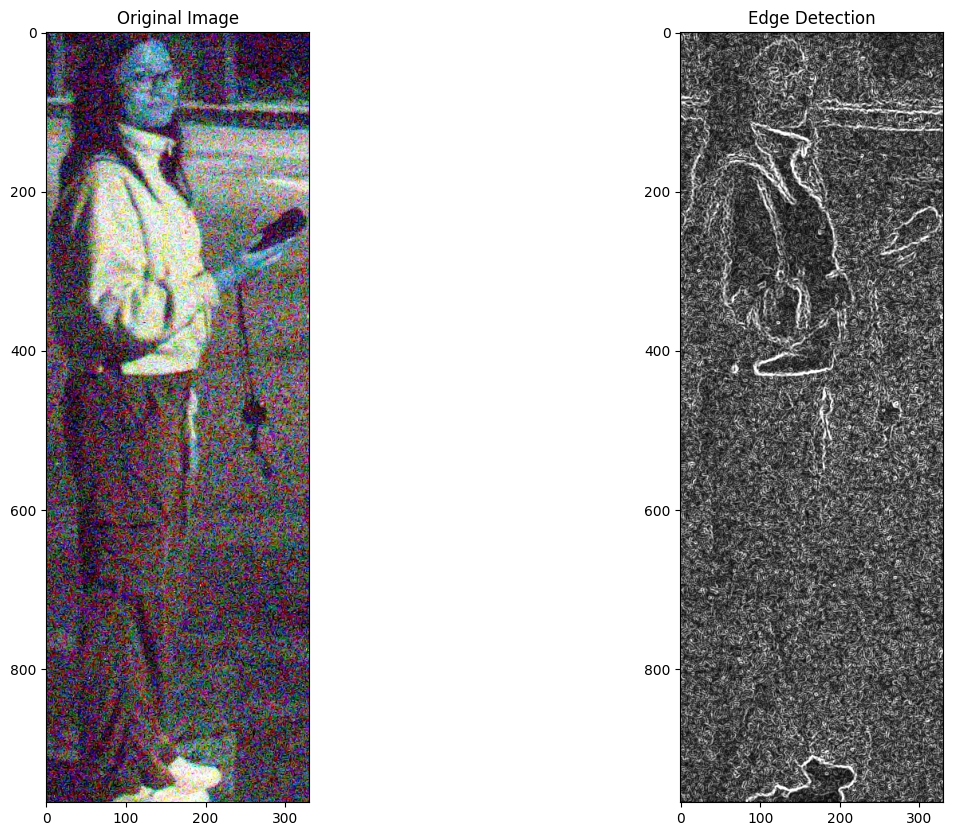

83.83802838880428
20241007-7A0-cv.jpg


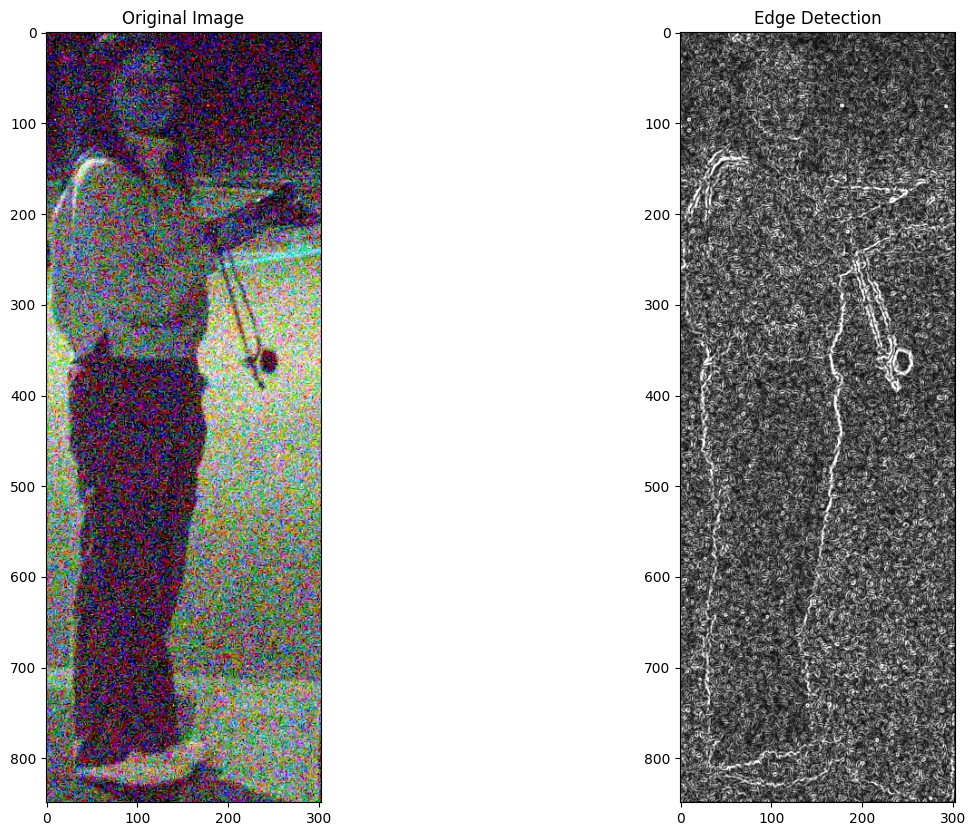

86.90388614833215
20241007-7B0-cv.jpg


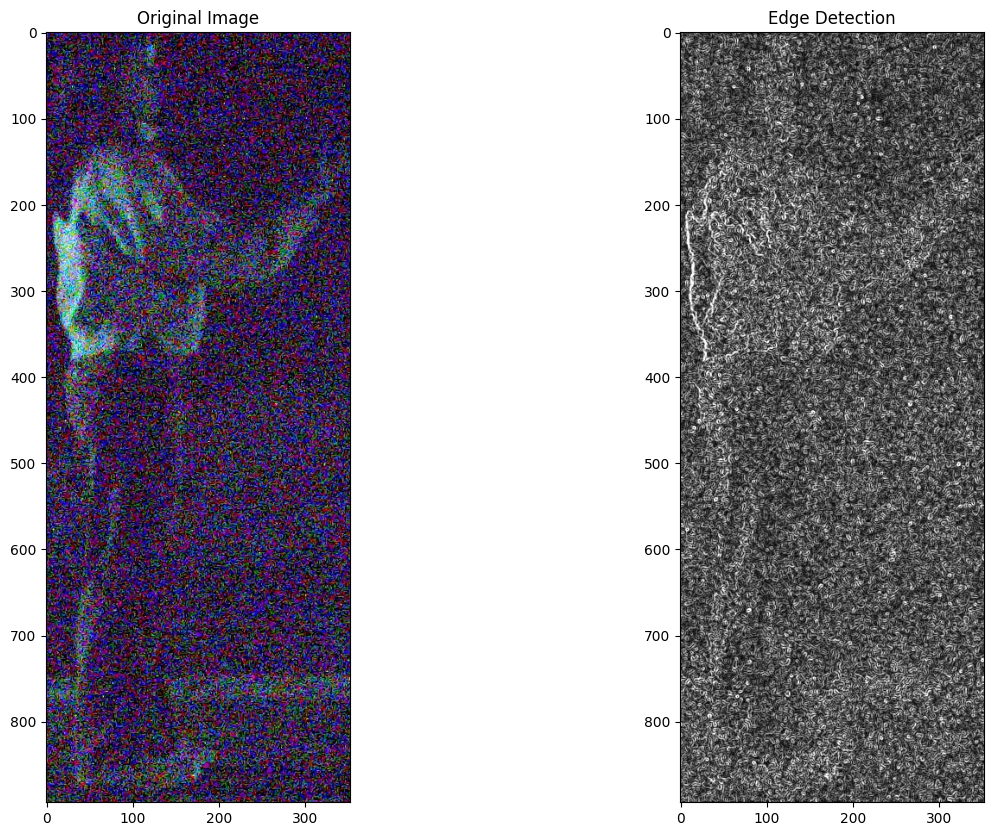

85.41902579995056
20241007-8A0-cv.jpg


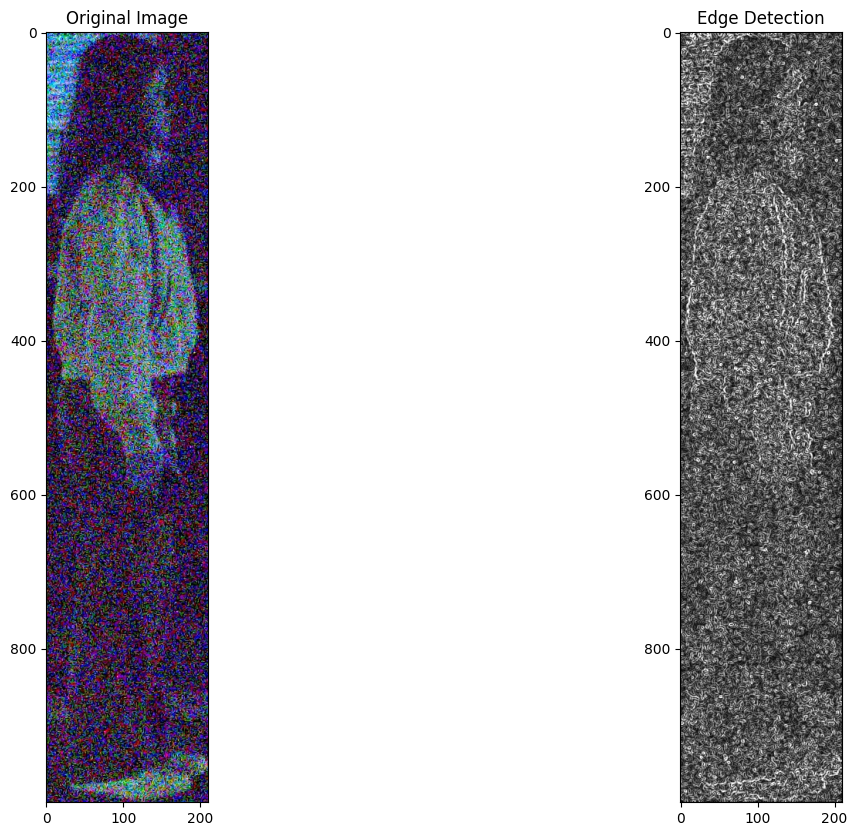

90.36584285714285
20241007-8B0-cv.jpg


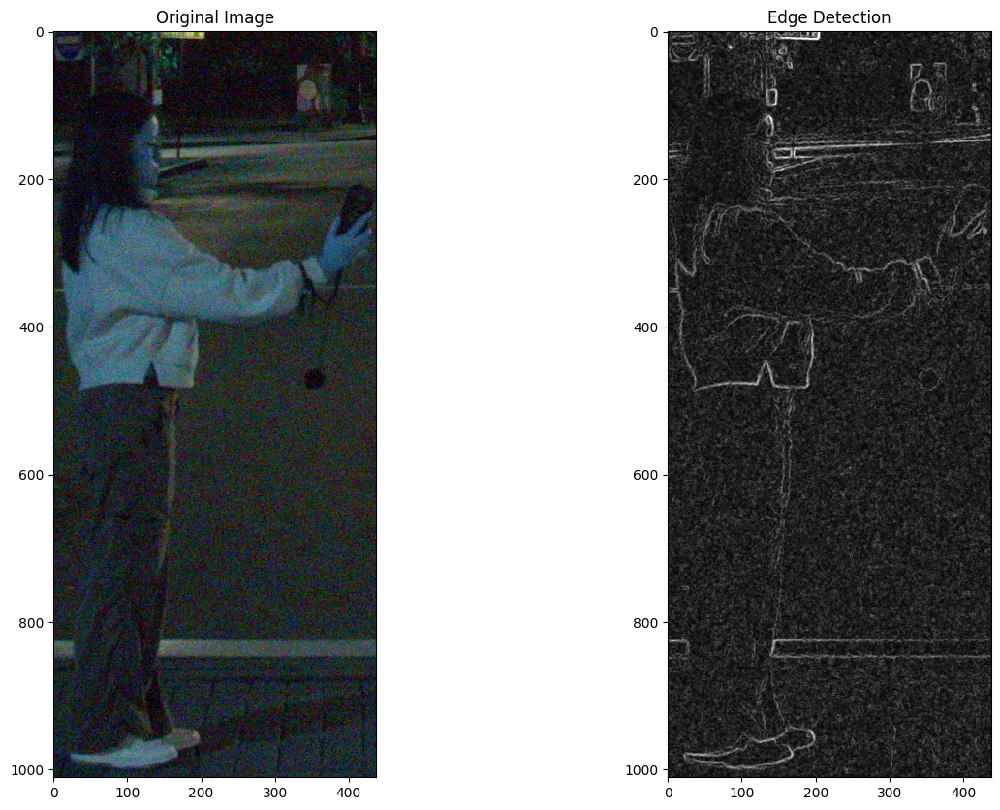

34.79846347709443
20241007-9A0-cv.jpg


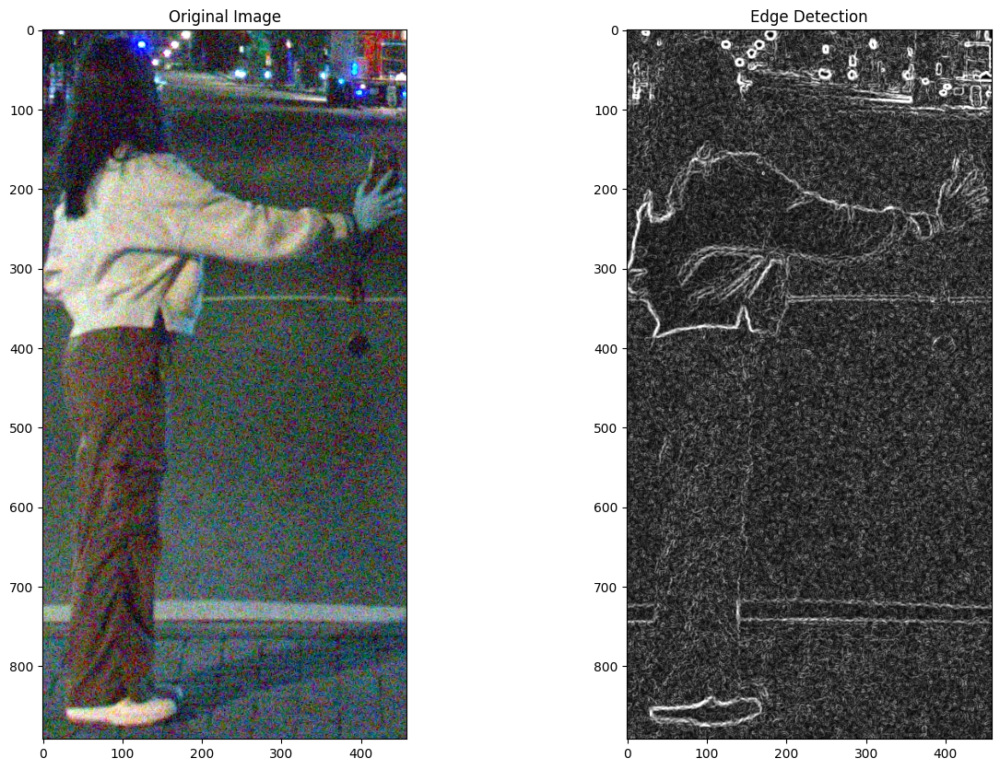

57.64026670844185
20241007-9B0-cv.jpg


In [86]:
directory = "cropped_images"

def custom_sort_key(filename):
    # Match the pattern YYYYMMDD-8B0-cv.jpg
    match = re.match(r"\d{8}-(\w+)-cv\.jpg", filename)
    if match:
        # Extract the relevant part (8B0 in this case)
        return (match.group(1), filename)  # First sort by the alphanumeric part
    return (filename, )  # Fallback for unexpected formats

file_list = os.listdir(directory)
sorted_files = sorted(file_list, key=custom_sort_key)


for filename in sorted_files:
    image_path = os.path.join(directory, filename)
    edges = sobel_edges(image_path)
    print(filename)
    # plt.imshow(edges)

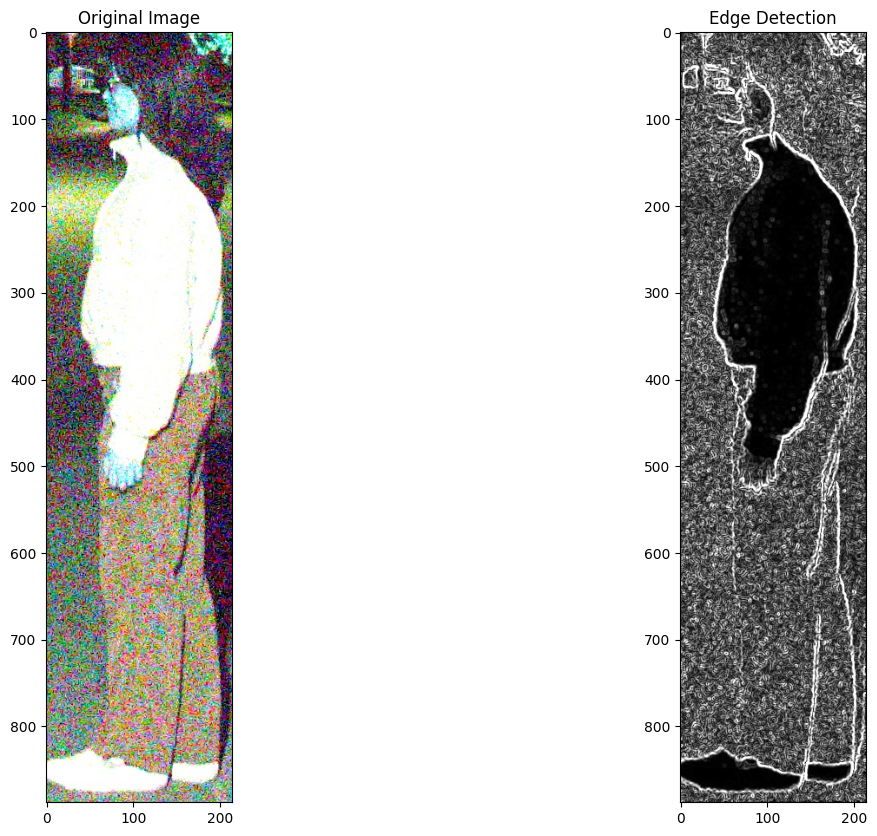

77.2512682074598


In [80]:
sobel_edges("cropped_images/20241007-1B2-cv.jpg")

In [1]:
def canny_edges(image_path):
    image = cv.imread(str(image_path))
    gray_image = cv.cvtColor(image, cv.COLOR_BGR2GRAY)
    
    clip_limit = 100
    grid_size=3
    sigmaG=10
    
    clahe = cv.createCLAHE(clipLimit=clip_limit, tileGridSize =(grid_size,grid_size))
    equ=clahe.apply(gray_image)
    val=sk.filters.threshold_otsu(equ)
    mask= gray_image<val
    

    # blurred_image = cv.GaussianBlur(gray_image,(3,3),0)
    mask=sk.filters.gaussian(mask,sigma=sigmaG)
    G = sk.feature.canny(mask,sigma=sigmaG)
    

    avg_g = np.mean(G)

    plt.figure(figsize=(15,10))

    plt.subplot(1,2,1)
    plt.imshow(cv.cvtColor(image,cv.COLOR_BGR2RGB))
    plt.title('Original Image')
    
    plt.subplot(1,2,2)
    plt.imshow(image_erode,cmap='gray')
    plt.title('Edge Detection')

    plt.show()
    print(avg_g)

directory = "cropped_images/"

for filename in os.listdir(directory):
    image_path = os.path.join(directory, filename)
    canny_edges(image_path)

NameError: name 'os' is not defined

In [ ]:
def canny_two(image_path):
    gray_image = cv.cvtColor(image_path, cv.COLOR_BGR2GRAY)
    image_blur = cv.GaussianBlur(gray_image,(11,11),7)
    image_canny = cv.Canny(image_blur,0,10)

    kernel = np.ones((19,19))
    image_dilate = cv.dilate(image_canny, kernel, iterations=4)
    image_erode = cv.erode(image_dilate,kernel,iterations=4)
    return image_erode

def draw_contours(image_path):
    contours, hierarchies=cv.findContours(canny_two(image_path),cv.RETR_EXTERNAL,cv.CHAIN_APPROX_NONE)
    cnt=max(contours,key=cv.contourArea)
    peri=cv.arcLength(cnt,True)
    approx=cv.approxPolyDP(cnt,0.004*peri,True)
    cv.drawContours(image_path,[approx],-1,(255,255,0),2)



directory = "cropped_images/"

for filename in os.listdir(directory):
    image_path = os.path.join(directory, filename)
    img=cv.imread(image_path)
    h,w,c=img.shape
    img=cv.resize(img,(w//2,h//2))
    draw_contours(img)
    cv.imshow("Image",img)

    cv.waitKey(0)

qt.qpa.plugin: Could not find the Qt platform plugin "wayland" in "/home/ahur/SV/night-light/venv/lib/python3.12/site-packages/cv2/qt/plugins"
